#Introduction


Digital Signal Processing (DSP) plays a crucial role in the analysis of birdsong, offering information about species identification, population monitoring, and the overall health of an environment containing birds. Birdsong is a sound that varies between species providing data on behavior, territory, and communication. As urbanization and environmental noise increase, DSP techniques become even more important for telling the difference between different sounds when it contains complex background noise.

In my project I am applying DSP techniques to analyze birdsong recordings from three different locations the first was recorded in the car park of the college (ATU), while the other two were taken in a housing estate in the middle of the city. My objective is to explore how the ambient noise from urban environments affects the frequency patterns of birdsong. By comparing these recordings, I aim to understand whether the bird adjusts its calls based on the surrounding noise levels and how this may influence the bird's song frequency.

One of the main tools used in this analysis is the spectrogram, a graphical way of displaying how the frequency of a signal changes over time. Spectrograms are essential in bioacoustics for breaking down complex sounds into usable data, Spectrograms are not only useful for recognizing and classifying birdsong but are also very important in denoising techniques. For example combining wavelet denoising with Phase Spectrum Compensation helps reduce background noise making it easier to focus on the relevant frequency components of the birdsong (Babu et al., 2022).


References:
Fu, Y., Yu, C., Zhang, Y., Lv, D., Yin, Y., Lu, J., & Lv, D. (2023). Classification of birdsong spectrograms based on DR-ACGAN and dynamic convolution. Ecological Informatics. https://doi.org/10.1016/j.ecoinf.2023.102250


Babu, G. R., Vamsidhar, A., Kavitha, T. S., & Sridhar, G. (2022). A Birdsong Denoising using Cascaded Combination of Phase Spectrum Compensation and Wavelets. 19–25.
Avaliable at: https://www.researchgate.net/publication/361312038_A_Birdsong_Denoising_using_Cascaded_Combination_of_Phase_Spectrum_Compensation_and_Wavelets

## Import Libraries


In [ ]:
import numpy as np
from scipy.io import wavfile
import IPython.display as ipd
import matplotlib.pyplot as plt
from scipy import signal
from scipy.io import wavfile
from google.colab import drive
import librosa
import librosa.display
drive.mount('/content/drive')

Mounted at /content/drive


#Birdsong Audio

##Birdsong Audio Collection and Processing
For this project, I recorded three samples of birdsong from different locations to analyze how environmental noise influences the songs of birds. The first recording was taken in the car park of ATU while the other two were recorded in a housing estate in the middle of the city. I selected these locations to compare how urban ambient noise affects the frequency content of birdsong in different environments.

To capture the audio, I used the Memos app on my phone, which allowed for convenient recording. The recordings were initially saved in MP4 forma but since digital signal processing techniques and spectrogram analysis work best with uncompressed audioI converted the files from MP4 to WAV using an online conversion tool. The WAV format preserves more of the original frequency content ensuring no audio is lost due to compression.

To identify the bird species in the recordings, I used the Merlin Bird ID app a tool designed to identify birds. The app identified the bird in all three recordings as a starling (Sturnus vulgaris) a highly vocal species known for their ability to mimic sounds and produce varied calls.

I witnessed one starling produce various different types of birdsong within a small period which is why I captured two audio recordings of the same bird so I can compare and analyse the birdsong recordings to see if they are in the same frequency ranges.

## Read Audio File


In [ ]:
rate, audio = wavfile.read('/content/drive/MyDrive/Spectrograms/ATU_birdsong.wav')

In [ ]:
ipd.Audio(audio, rate=rate)

#Spectogram Analysis


##Creating Functions for plotting

In [ ]:
# Function to plot the original audio in the time-domain
def plot_time_domain():
    fig = plt.figure(figsize=(14,10))
    ax = fig.add_subplot(111)
    ax.plot(np.arange(N) / (rate*4), audio)
    ax.set_title('Birdsong', fontsize=26, pad=10, color='sienna');
    ax.set_xlabel('Time (s)', fontsize=20, labelpad=10)
    ax.set_ylabel('Amplitude', fontsize=20, labelpad=10);

In [ ]:
# Function to plot the spectrogram, parameters may require tuning depending on the audio file
def plot_spec_scipy():
    fig, ax = plt.subplots(figsize=(18,14))
    im = ax.pcolormesh(times_sp, freqs_sp/1000, spec_db_sp, vmax=spec_db_sp.max(), vmin=20, cmap=plt.cm.gist_yarg, linewidth=10, shading='auto')
    cb = fig.colorbar(im, ax=ax, orientation="horizontal")
    ax.set_ylabel('Frequency (kHz)', fontsize=26, labelpad=10)
    ax.set_xlabel('Time (s)', fontsize=26, labelpad=10);
    ax.set_title('Birdsong Spectrogram', fontsize=26, pad=10, color='sienna');
    ax.set_title('Birdsong', fontsize=26, pad=10, color='sienna');
    ax.set_ylim(0, 20)
    ax.set_xlim(0, 35)
    ax.tick_params(axis='both', which='both', labelsize=22, length=0)
    cb.set_label('Power (dB)', fontsize=26, labelpad=10)
    cb.ax.tick_params(labelsize=22)




In [ ]:
#Plot Spectrogram
def plot_spec_scipy_filtered():
    freqs_sp_filtered, times_sp_filtered, spec_sp_filtered = signal.spectrogram(amplified_audio, fs=rate, window=('tukey', 0.25),
                                            nperseg=1024, noverlap=1024-100,
                                            detrend=False, scaling='spectrum')
    spec_db_sp_filtered = 10*np.log10(spec_sp_filtered + 1e-10) # Adding a small offset to avoid log10(0)

    fig, ax = plt.subplots(figsize=(18,14))
    im = ax.pcolormesh(times_sp_filtered, freqs_sp_filtered/1000, spec_db_sp_filtered, vmax=spec_db_sp_filtered.max(), vmin=20, cmap=plt.cm.gist_yarg, linewidth=10, shading='auto')
    cb = fig.colorbar(im, ax=ax, orientation="horizontal")
    ax.set_ylabel('Frequency (kHz)', fontsize=26, labelpad=10)
    ax.set_xlabel('Time (s)', fontsize=26, labelpad=10);
    ax.set_title('Filtered Birdsong Spectrogram', fontsize=26, pad=10, color='sienna');
    ax.set_ylim(0, 20)
    ax.set_xlim(0, 35)
    ax.tick_params(axis='both', which='both', labelsize=22, length=0)
    cb.set_label('Power (dB)', fontsize=26, labelpad=10)
    cb.ax.tick_params(labelsize=22)


##Plotting The Graphs

###Non-Birdsong Audio(ATU Carpark)

In [ ]:
rate, audio = wavfile.read('/content/drive/MyDrive/Spectrograms/ATU_birdsong.wav')
N = audio.shape[0]
L = N / (rate*4)
print(f'Audio length: {L:.2f} seconds')
freqs_sp, times_sp, spec_sp = signal.spectrogram(audio, fs=rate, window=('tukey', 0.25),
                                            nperseg=1024, noverlap=1024-100,
                                            detrend=False, scaling='spectrum')
spec_db_sp = 10*np.log10(spec_sp + 1e-10) # Adding a small offset to avoid log10(0)

Audio length: 90.84 seconds


This spectrogram shows that my audio is extremely noisy the only recognisable audio of bird song is at 60 seconds in at about 9Khz I will try my best to filter out the higher and lower frequencies and try to amplifiy this one freqency at the 9Khz

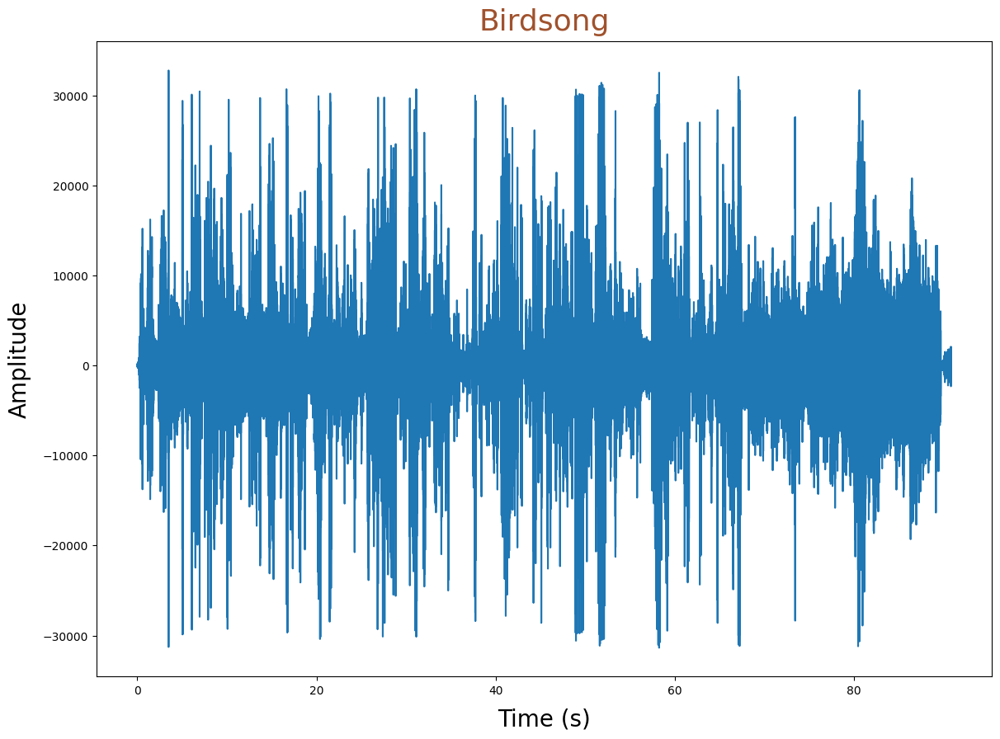

In [ ]:
plot_time_domain();

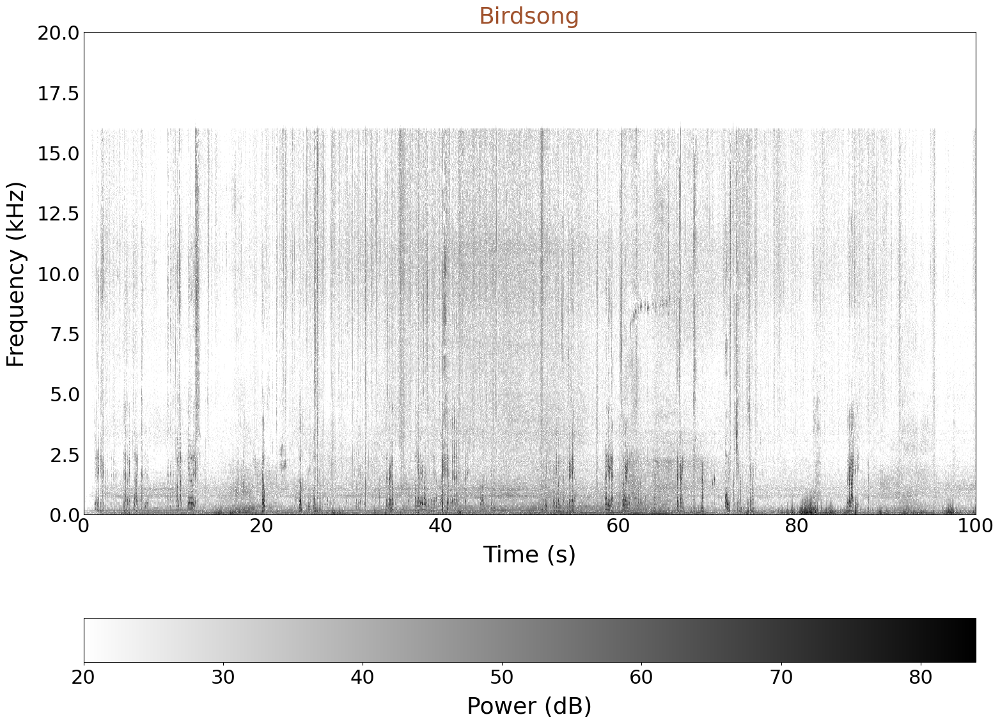

In [ ]:
plot_spec_scipy();

###BirdSong Audio(Inner City)

In [ ]:
rate, audio = wavfile.read('/content/drive/MyDrive/Spectrograms/birdsong_galwaycc.wav')
N = audio.shape[0]
L = N / (rate)
print(f'Audio length: {L:.2f} seconds')
freqs_sp, times_sp, spec_sp = signal.spectrogram(audio, fs=rate, window=('tukey', 0.25),
                                            nperseg=1024, noverlap=1024-100,
                                            detrend=False, scaling='spectrum')
spec_db_sp = 10*np.log10(spec_sp + 1e-10) # Adding a small offset to avoid log10(0)

Audio length: 31.53 seconds


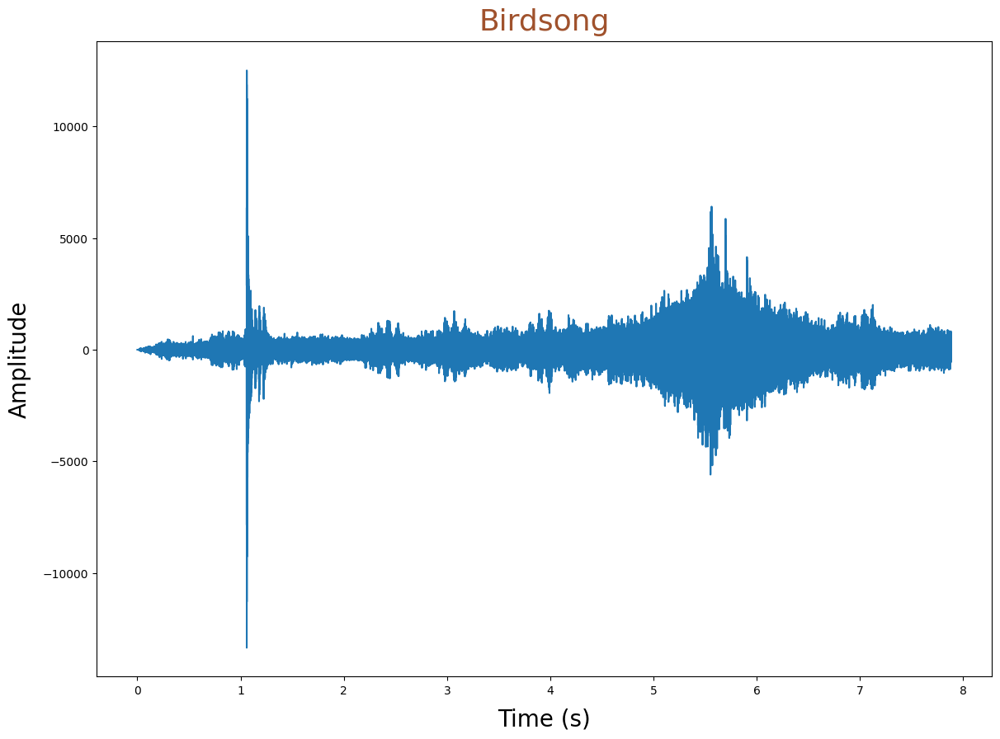

In [ ]:
plot_time_domain();

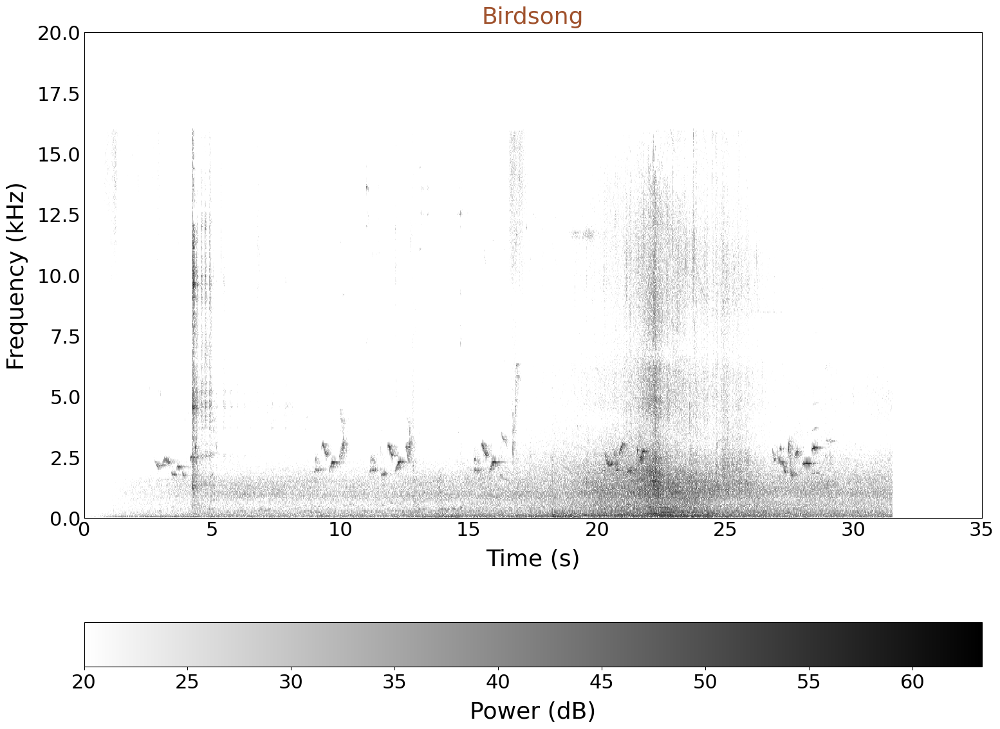

In [ ]:
plot_spec_scipy();

###Same Bird Different Audio(Inner City)

For this section of my analysis I am looking at a recording I took immediately after the first bit of bird song audio I collected to see if the bird was producing different freqencies with different songs it was producing as i noticed that the song coming from the bird differed in each one it did sometimes so I will anaylise it now and see

In [ ]:
rate, audio = wavfile.read('/content/drive/MyDrive/Spectrograms/birdsong_galwaycc_same.wav')
N = audio.shape[0]
L = N / (rate)
print(f'Audio length: {L:.2f} seconds')
freqs_sp, times_sp, spec_sp = signal.spectrogram(audio, fs=rate, window=('tukey', 0.25),
                                            nperseg=1024, noverlap=1024-100,
                                            detrend=False, scaling='spectrum')
spec_db_sp = 10*np.log10(spec_sp + 1e-10) # Adding a small offset to avoid log10(0)

Audio length: 30.72 seconds


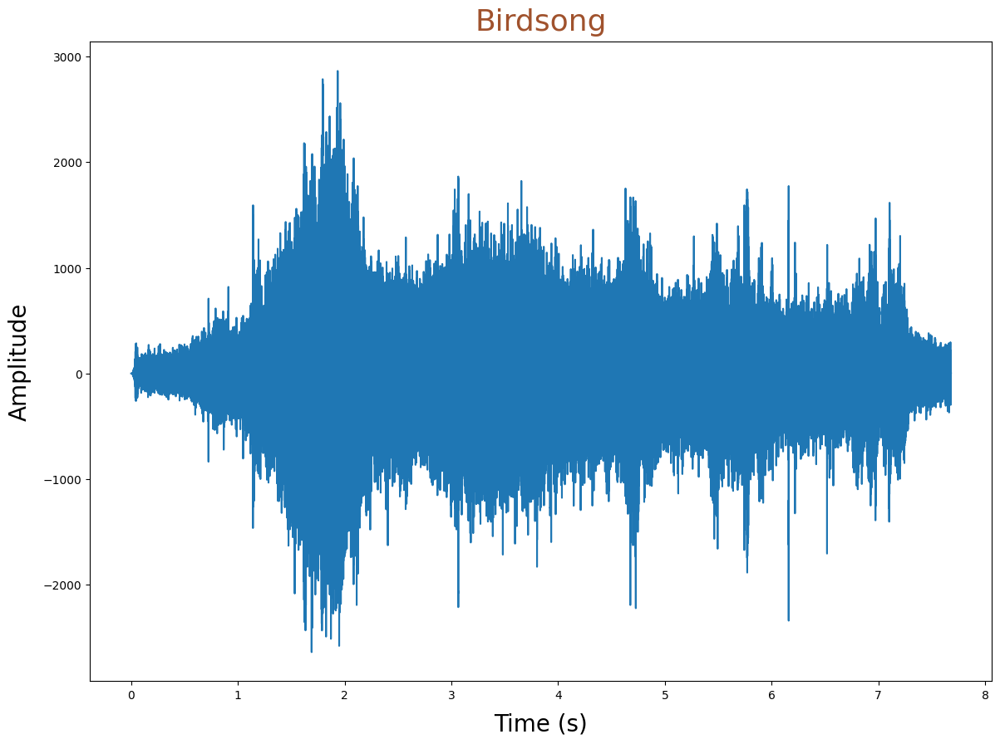

In [ ]:
plot_time_domain();

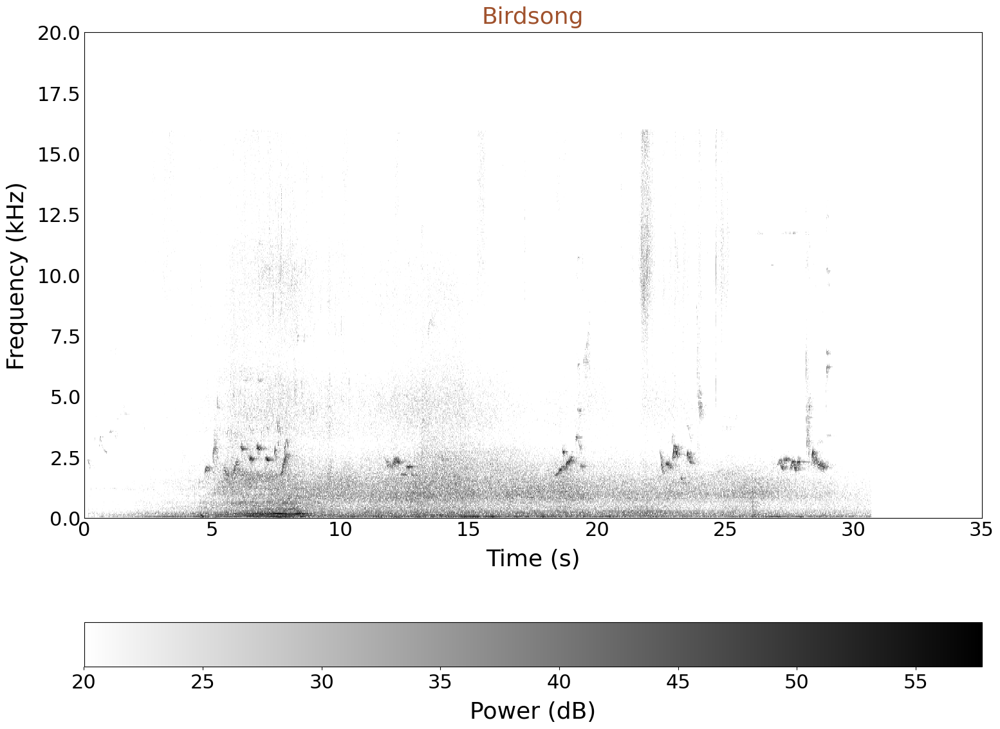

In [ ]:
plot_spec_scipy();

#Comparison of Both birdsong audio(Inner city)

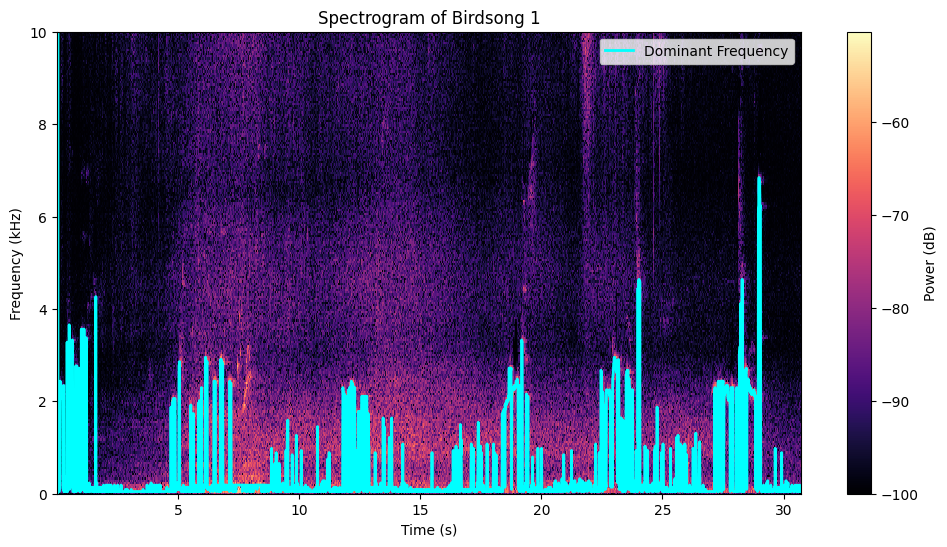

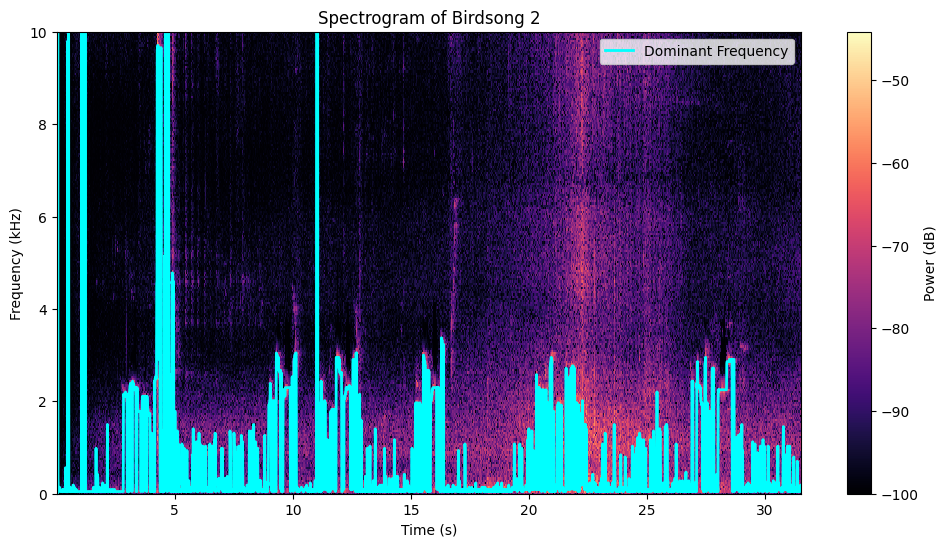

In [ ]:

def plot_spectrogram(audio, rate, title="Spectrogram"):
    # Generate spectrogram
    f, t, Sxx = signal.spectrogram(audio, fs=rate, nperseg=1024, noverlap=512)

    # Convert to dB scale
    Sxx_db = 10 * np.log10(Sxx + 1e-10)  # Avoid log(0)

    # Plot
    plt.figure(figsize=(12, 6))
    plt.pcolormesh(t, f/1000, Sxx_db, shading='auto', cmap='magma')
    plt.colorbar(label="Power (dB)")
    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (kHz)")
    plt.title(title)

    # Highlight dominant frequencies
    peak_freqs = np.argmax(Sxx, axis=0)  # Get index of max power for each time step
    plt.plot(t, f[peak_freqs]/1000, color="cyan", linewidth=2, label="Dominant Frequency")

    plt.legend()
    plt.ylim(0, 10)  # Focus on bird vocalization range
    plt.show()

# Load and process audio
file_paths = ["/content/drive/MyDrive/Spectrograms/birdsong_galwaycc_same.wav", "/content/drive/MyDrive/Spectrograms/birdsong_galwaycc.wav"]
for i, file in enumerate(file_paths):
    audio, rate = librosa.load(file, sr=None)  # Load audio with original sampling rate
    plot_spectrogram(audio, rate, title=f"Spectrogram of Birdsong {i+1}")


In [ ]:
def compute_snr(audio):
    # Compute power of signal and noise
    signal_power = np.mean(audio**2)
    noise_power = np.var(audio)  # Estimate noise as variance
    snr = 10 * np.log10(signal_power / (noise_power + 1e-10))
    return snr

def analyze_frequency_content(audio, rate):
    # Compute spectrogram
    f, t, Sxx = signal.spectrogram(audio, fs=rate, nperseg=1024, noverlap=512)

    # Find dominant frequencies at each time step
    dominant_freqs = f[np.argmax(Sxx, axis=0)]

    # Compute mean dominant frequency and bandwidth
    mean_freq = np.mean(dominant_freqs)
    bandwidth = np.max(dominant_freqs) - np.min(dominant_freqs)

    return mean_freq, bandwidth

# Process each recording
for i, file in enumerate(file_paths):
    audio, rate = librosa.load(file, sr=None)

    snr = compute_snr(audio)
    mean_freq, bandwidth = analyze_frequency_content(audio, rate)

    print(f"Analysis for {file}:")
    print(f"- Signal-to-Noise Ratio (SNR): {snr:.2f} dB")
    print(f"- Mean Dominant Frequency: {mean_freq/1000:.2f} kHz")
    print(f"- Frequency Bandwidth: {bandwidth/1000:.2f} kHz")
    print("------------------------------------------------------")


Analysis for /content/drive/MyDrive/Spectrograms/birdsong_galwaycc_same.wav:
- Signal-to-Noise Ratio (SNR): -0.00 dB
- Mean Dominant Frequency: 0.47 kHz
- Frequency Bandwidth: 13.22 kHz
------------------------------------------------------
Analysis for /content/drive/MyDrive/Spectrograms/birdsong_galwaycc.wav:
- Signal-to-Noise Ratio (SNR): -0.00 dB
- Mean Dominant Frequency: 0.70 kHz
- Frequency Bandwidth: 15.94 kHz
------------------------------------------------------


##Findings from Birdsong Recordings
 I analyzed two birdsong recordings taken from different urban environments to understand how background noise influences the bird song. The Signal-to-Noise Ratio (SNR) for both recordings was approximately 0 dB, meaning that the power levels of the birdsong and background noise were almost equal. This means that both recordings were taken in relatively noisy environments where urban sounds such as traffic or human activity could be interfering with the bird calls. A low SNR makes it harder to distinguish the bird song from background noise.

When looking at the mean dominant frequency, I noticed a slight increase in the second recording where the bird call averaged 0.70 kHz compared to 0.47 kHz in the first recording. This seems that the bird in the second audio recording was producing calls at a slightly higher frequency. Studies have shown that birds often shift their vocalizations upward in noisy areas to improve communication which could explain the difference observed between the two recordings.

Another interesting observation was the frequency bandwidth. The second recording had a wider bandwidth 15.94 kHz compared to the first 13.22 kHz. A bigger frequency range suggests that the bird is using a more varied call to ensure its song remains audible despite background noise.



#Filters

##Birdsong filter

In [ ]:
# Filter parameters
lowcut = 1500  # Low cut-off frequency (1 kHz)
highcut = 6000  # High cut-off frequency (6 kHz)

# Normalize the frequencies for filter design
nyquist = 0.5 * rate  # Nyquist frequency
low = lowcut / nyquist
high = highcut / nyquist

# Bandpass filter (Butterworth)
order = 4
b, a = signal.butter(order, [low, high], btype='band')

# Apply the filter
filtered_audio = signal.lfilter(b, a, audio)

# Amplify the filtered signal
amplification_factor = 10
amplified_audio = filtered_audio * amplification_factor

# Normalize the amplified audio
# Ensure values stay within the valid range for audio
max_value = np.iinfo(np.int16).max
amplified_audio = np.clip(amplified_audio, -max_value, max_value).astype(np.int16)


# Save the filtered and amplified audio
wavfile.write('/content/drive/MyDrive/Spectrograms/filtered_birdsong.wav', rate, amplified_audio)
print("Filtered and amplified audio saved.")


Filtered and amplified audio saved.


In [ ]:
plot_spec_scipy_filtered()

##Non-BirdSong audio filter

In [ ]:
#filter parameters
center_freq = 9000  # Center frequency (9kHz)
bandwidth = 2000  # Bandwidth around the center frequency
lowcut = center_freq - bandwidth / 2
highcut = center_freq + bandwidth / 2

# Normalize the frequencies for filter design
nyquist = 0.5 * rate
low = lowcut / nyquist
high = highcut / nyquist

#bandpass filter(Butterworth)
order = 4
b, a = signal.butter(order, [low, high], btype='band')

#Apply the filter
filtered_audio = signal.lfilter(b, a, audio)

#Amplify the filtered signal
amplification_factor = 10
amplified_audio = filtered_audio * amplification_factor

# Normalize the amplified audio
# Ensure values stay within the valid range for audio
max_value = np.iinfo(np.int16).max
amplified_audio = np.clip(amplified_audio, -max_value, max_value).astype(np.int16)
ipd.Audio(amplified_audio, rate=rate)
#Save the Filtered and Amplified Audio
wavfile.write('/content/drive/MyDrive/Spectrograms/filtered_audio.wav', rate, amplified_audio)
print("Filtered and amplified audio saved.")

After plotting the spectrogram and listening to the audio it did cut off the higher and lower freqencies and amplified frequencies between 7.5 and 10Khz
but upon listening to the origional audio I realised what I was amplifing was not even bird song but nice to know the band-pass filter i created works.

In [ ]:
plot_spec_scipy_filtered()

##Same Bird different audio Filter

In [ ]:
# Filter parameters
lowcut = 1250  # Low cut-off frequency (1 kHz)
highcut = 7500  # High cut-off frequency (6 kHz)

# Normalize the frequencies for filter design
nyquist = 0.5 * rate  # Nyquist frequency
low = lowcut / nyquist
high = highcut / nyquist

# Bandpass filter (Butterworth)
order = 4
b, a = signal.butter(order, [low, high], btype='band')

# Apply the filter
filtered_audio = signal.lfilter(b, a, audio)

# Amplify the filtered signal
amplification_factor = 10
amplified_audio = filtered_audio * amplification_factor

# Normalize the amplified audio
# Ensure values stay within the valid range for audio
max_value = np.iinfo(np.int16).max
amplified_audio = np.clip(amplified_audio, -max_value, max_value).astype(np.int16)


# Save the filtered and amplified audio
wavfile.write('/content/drive/MyDrive/Spectrograms/filtered_birdsong.wav', rate, amplified_audio)
print("Filtered and amplified audio saved.")


Filtered and amplified audio saved.


In [ ]:
plot_spec_scipy_filtered()

##Filter Effect Analysis

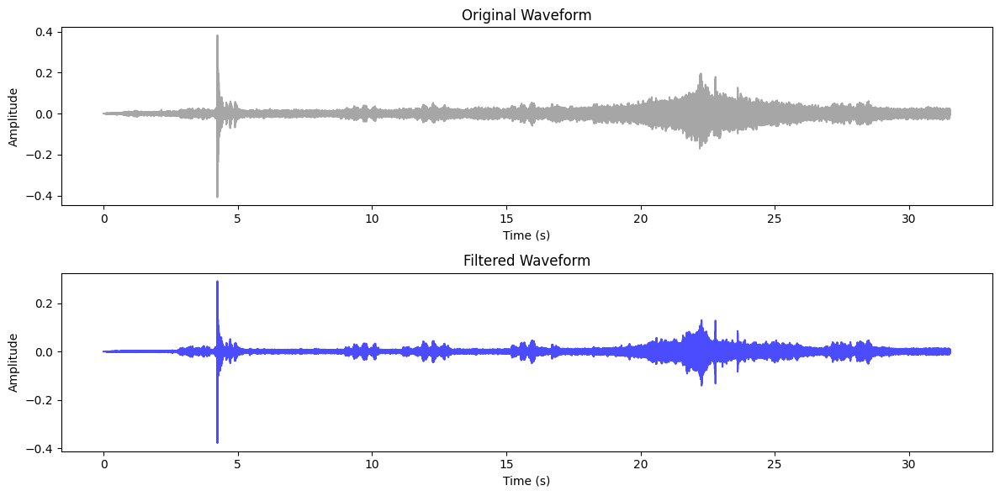

In [ ]:
def plot_waveform(audio_original, audio_filtered, rate, title="Waveform Comparison"):
    time = np.linspace(0, len(audio_original) / rate, num=len(audio_original))

    plt.figure(figsize=(12, 6))

    # Plot original waveform
    plt.subplot(2, 1, 1)
    plt.plot(time, audio_original, color='gray', alpha=0.7, label="Original Audio")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.title("Original Waveform")

    # Plot filtered waveform
    plt.subplot(2, 1, 2)
    plt.plot(time, audio_filtered, color='blue', alpha=0.7, label="Filtered Audio")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.title("Filtered Waveform")

    plt.tight_layout()
    plt.show()

# Load the audio file
file_path = "/content/drive/MyDrive/Spectrograms/birdsong_galwaycc.wav"
audio, rate = librosa.load(file_path, sr=None)

# Apply the bandpass filter (from your existing filter function)
filtered_audio = signal.lfilter(b, a, audio)

# Plot waveforms before and after filtering
plot_waveform(audio, filtered_audio, rate)


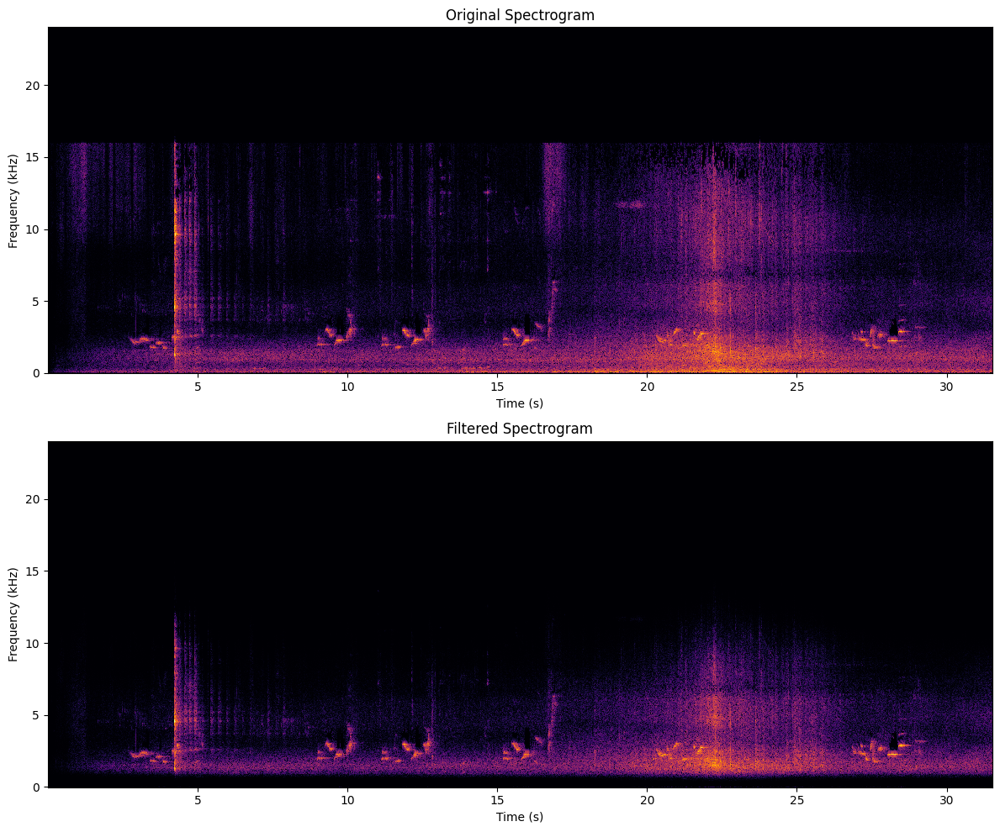

In [ ]:
def plot_filtered_spectrogram(audio_original, audio_filtered, rate):
    f1, t1, Sxx1 = signal.spectrogram(audio_original, fs=rate, nperseg=1024, noverlap=512)
    f2, t2, Sxx2 = signal.spectrogram(audio_filtered, fs=rate, nperseg=1024, noverlap=512)

    # Convert to dB scale
    Sxx1_db = 10 * np.log10(Sxx1 + 1e-10)
    Sxx2_db = 10 * np.log10(Sxx2 + 1e-10)

    fig, axs = plt.subplots(2, 1, figsize=(12, 10))

    # Original spectrogram
    axs[0].pcolormesh(t1, f1/1000, Sxx1_db, shading='auto', cmap='inferno')
    axs[0].set_ylabel("Frequency (kHz)")
    axs[0].set_xlabel("Time (s)")
    axs[0].set_title("Original Spectrogram")

    # Filtered spectrogram
    axs[1].pcolormesh(t2, f2/1000, Sxx2_db, shading='auto', cmap='inferno')
    axs[1].set_ylabel("Frequency (kHz)")
    axs[1].set_xlabel("Time (s)")
    axs[1].set_title("Filtered Spectrogram")

    plt.tight_layout()
    plt.show()

# Plot spectrograms before and after filtering
plot_filtered_spectrogram(audio, filtered_audio, rate)


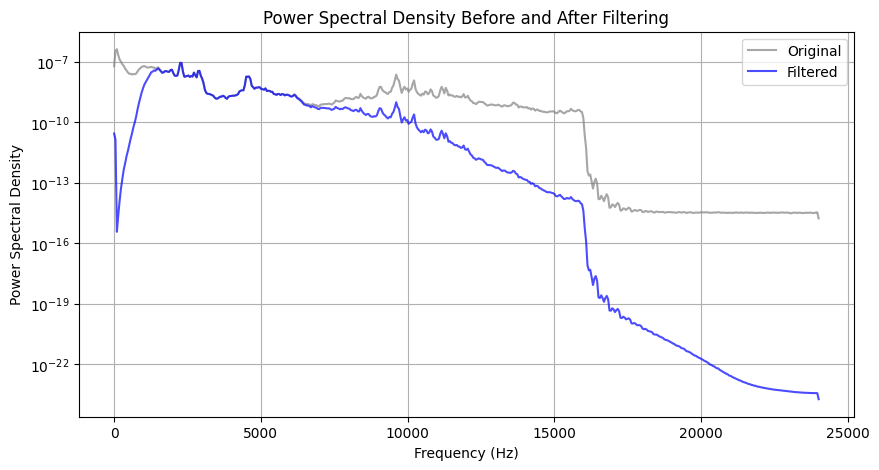

In [ ]:
def plot_psd(audio_original, audio_filtered, rate):
    f1, Pxx1 = signal.welch(audio_original, fs=rate, nperseg=1024)
    f2, Pxx2 = signal.welch(audio_filtered, fs=rate, nperseg=1024)

    plt.figure(figsize=(10, 5))
    plt.semilogy(f1, Pxx1, color='gray', alpha=0.7, label="Original")
    plt.semilogy(f2, Pxx2, color='blue', alpha=0.7, label="Filtered")
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Power Spectral Density")
    plt.title("Power Spectral Density Before and After Filtering")
    plt.legend()
    plt.grid()
    plt.show()

# Plot PSD
plot_psd(audio, filtered_audio, rate)


In [ ]:
def compute_spectral_features(audio, rate):
    spectral_centroid = librosa.feature.spectral_centroid(y=audio, sr=rate)
    spectral_bandwidth = librosa.feature.spectral_bandwidth(y=audio, sr=rate)

    return np.mean(spectral_centroid), np.mean(spectral_bandwidth)

# Compute features for both original and filtered recordings
centroid_original, bandwidth_original = compute_spectral_features(audio, rate)
centroid_filtered, bandwidth_filtered = compute_spectral_features(filtered_audio, rate)

print(f"Spectral Centroid (Original): {centroid_original/1000:.2f} kHz")
print(f"Spectral Bandwidth (Original): {bandwidth_original/1000:.2f} kHz")
print(f"Spectral Centroid (Filtered): {centroid_filtered/1000:.2f} kHz")
print(f"Spectral Bandwidth (Filtered): {bandwidth_filtered/1000:.2f} kHz")


Spectral Centroid (Original): 3.99 kHz
Spectral Bandwidth (Original): 4.16 kHz
Spectral Centroid (Filtered): 3.33 kHz
Spectral Bandwidth (Filtered): 2.27 kHz


#Reflection